### Import Packages

In [1]:
import pandas as pd
import numpy as np
import data_preprocess as dp
import data_visualization as dv
import geopandas as gpd
from shapely.geometry import Point, LineString
import matplotlib.pyplot as plt

### Read Data

In [2]:
# get the mahattan id list
json_path = './data/NYC Taxi Zones.geojson' # the taxi zones geojson path
m_ids = dp.get_mids(json_path) # get the mahattan ids
m_ids

3        4
9       24
12      12
13      13
40      41
      ... 
246    244
248    246
251    249
261    261
262    262
Name: location_id, Length: 66, dtype: object

In [3]:
# get a wohle years data in manhattan
data_path_list = [
  'data/yellow_tripdata_2022-01.parquet',
  'data/yellow_tripdata_2022-02.parquet',
  'data/yellow_tripdata_2022-03.parquet',
  'data/yellow_tripdata_2022-04.parquet',
  'data/yellow_tripdata_2022-05.parquet',
  'data/yellow_tripdata_2022-06.parquet',
  'data/yellow_tripdata_2022-07.parquet',
  'data/yellow_tripdata_2022-08.parquet',
  'data/yellow_tripdata_2022-09.parquet',
  'data/yellow_tripdata_2022-10.parquet',
  'data/yellow_tripdata_2022-11.parquet',
  'data/yellow_tripdata_2022-12.parquet'
]
start_time = '2022/01/01'
end_time = '2023/01/01'
m_tripdata = dp.get_tripdata(data_path_list, m_ids, start_time, end_time)
m_tripdata
  

,index,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,...,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,airport_fee,count
0,0,1,2022-01-01 00:35:40,2022-01-01 00:53:29,2.0,3.80,1.0,N,142,236,...,14.50,3.0,0.5,3.65,0.0,0.3,21.95,2.5,0.0,1
1,1,1,2022-01-01 00:33:43,2022-01-01 00:42:07,1.0,2.10,1.0,N,236,42,...,8.00,0.5,0.5,4.00,0.0,0.3,13.30,0.0,0.0,1
2,2,2,2022-01-01 00:53:21,2022-01-01 01:02:19,1.0,0.97,1.0,N,166,166,...,7.50,0.5,0.5,1.76,0.0,0.3,10.56,0.0,0.0,1
3,3,2,2022-01-01 00:25:21,2022-01-01 00:35:23,1.0,1.09,1.0,N,114,68,...,8.00,0.5,0.5,0.00,0.0,0.3,11.80,2.5,0.0,1
4,4,2,2022-01-01 00:36:48,2022-01-01 01:14:20,1.0,4.30,1.0,N,68,163,...,23.50,0.5,0.5,3.00,0.0,0.3,30.30,2.5,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32716045,3399540,2,2022-12-31 23:01:46,2022-12-31 23:26:45,NaN,3.97,NaN,None,107,50,...,23.55,0.0,0.5,5.51,0.0,1.0,33.06,NaN,NaN,1
32716046,3399542,2,2022-12-31 23:06:51,2022-12-31 23:17:08,NaN,0.91,NaN,None,68,48,...,17.65,0.0,0.5,4.33,0.0,1.0,25.98,NaN,NaN,1
32716047,3399543,2,2022-12-31 23:16:37,2022-12-31 23:34:19,NaN,7.50,NaN,None,263,261,...,33.63,0.0,0.5,3.76,0.0,1.0,41.39,NaN,NaN,1
32716048,3399545,2,2022-12-31 23:13:24,2022-12-31 23:29:08,NaN,5.06,NaN,None,75,50,...,26.23,0.0,0.5,0.00,0.0,1.0,30.23,NaN,NaN,1


In [4]:
m_tripdata['PULocationID'].value_counts()

237    1787984
236    1600505
161    1450073
142    1235271
186    1210380
        ...   
194       1433
202        792
153        259
128        163
120        135
Name: PULocationID, Length: 66, dtype: int64

In [5]:
import matplotlib.pyplot as plt
import seaborn as sns
def data_heatmap(data):
    # create a new dataframe with all possible combinations of PULocationID and DOLocationID
    heatmap_df = data.pivot(index='PULocationID', columns='DOLocationID', values='count')

    # create heatmap
    plt.figure(figsize=(50, 40))
    sns.heatmap(heatmap_df,cmap='Reds')
    plt.title('Heatmap of Taxi OD Locations')
    plt.xlabel('Drop-off Location')
    plt.ylabel('Pick-up Location')
    plt.show()

In [6]:
counts = m_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')

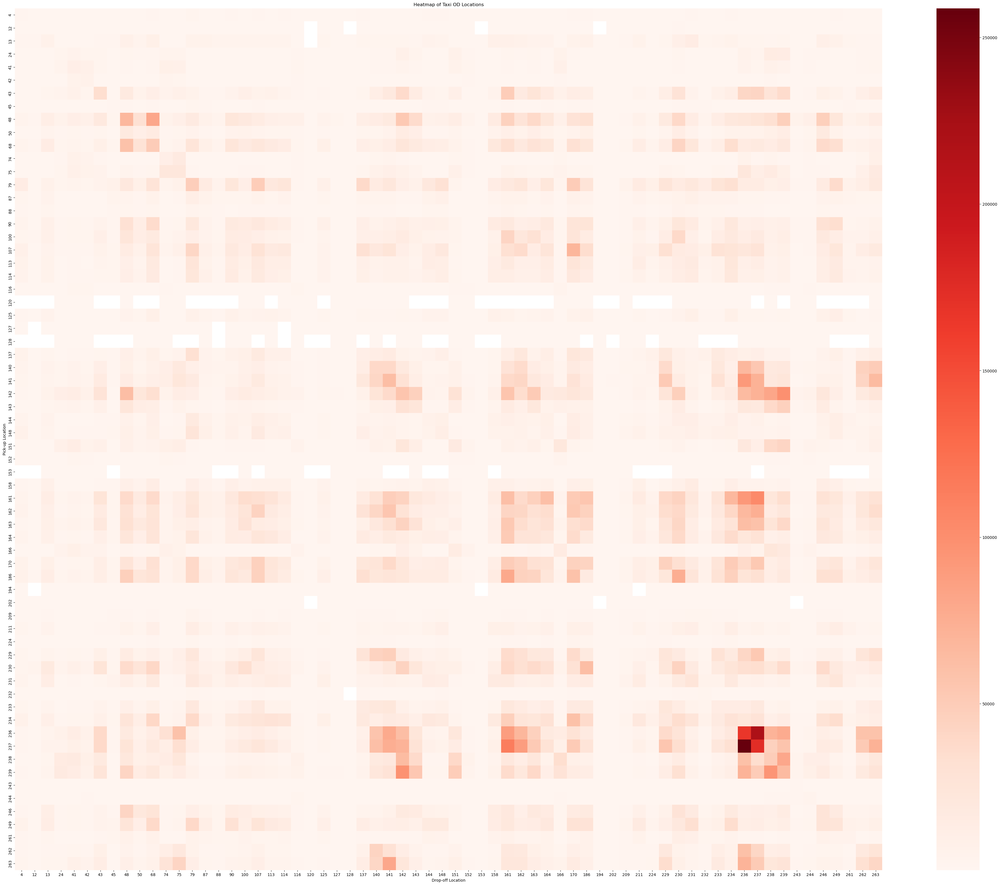

In [7]:
data_heatmap(counts)

### hours

In [8]:
m_tripdata['hour'] = m_tripdata['tpep_pickup_datetime'].dt.hour
m_tripdata

,index,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,...,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,airport_fee,count,hour
0,0,1,2022-01-01 00:35:40,2022-01-01 00:53:29,2.0,3.80,1.0,N,142,236,...,3.0,0.5,3.65,0.0,0.3,21.95,2.5,0.0,1,0
1,1,1,2022-01-01 00:33:43,2022-01-01 00:42:07,1.0,2.10,1.0,N,236,42,...,0.5,0.5,4.00,0.0,0.3,13.30,0.0,0.0,1,0
2,2,2,2022-01-01 00:53:21,2022-01-01 01:02:19,1.0,0.97,1.0,N,166,166,...,0.5,0.5,1.76,0.0,0.3,10.56,0.0,0.0,1,0
3,3,2,2022-01-01 00:25:21,2022-01-01 00:35:23,1.0,1.09,1.0,N,114,68,...,0.5,0.5,0.00,0.0,0.3,11.80,2.5,0.0,1,0
4,4,2,2022-01-01 00:36:48,2022-01-01 01:14:20,1.0,4.30,1.0,N,68,163,...,0.5,0.5,3.00,0.0,0.3,30.30,2.5,0.0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32716045,3399540,2,2022-12-31 23:01:46,2022-12-31 23:26:45,NaN,3.97,NaN,None,107,50,...,0.0,0.5,5.51,0.0,1.0,33.06,NaN,NaN,1,23
32716046,3399542,2,2022-12-31 23:06:51,2022-12-31 23:17:08,NaN,0.91,NaN,None,68,48,...,0.0,0.5,4.33,0.0,1.0,25.98,NaN,NaN,1,23
32716047,3399543,2,2022-12-31 23:16:37,2022-12-31 23:34:19,NaN,7.50,NaN,None,263,261,...,0.0,0.5,3.76,0.0,1.0,41.39,NaN,NaN,1,23
32716048,3399545,2,2022-12-31 23:13:24,2022-12-31 23:29:08,NaN,5.06,NaN,None,75,50,...,0.0,0.5,0.00,0.0,1.0,30.23,NaN,NaN,1,23


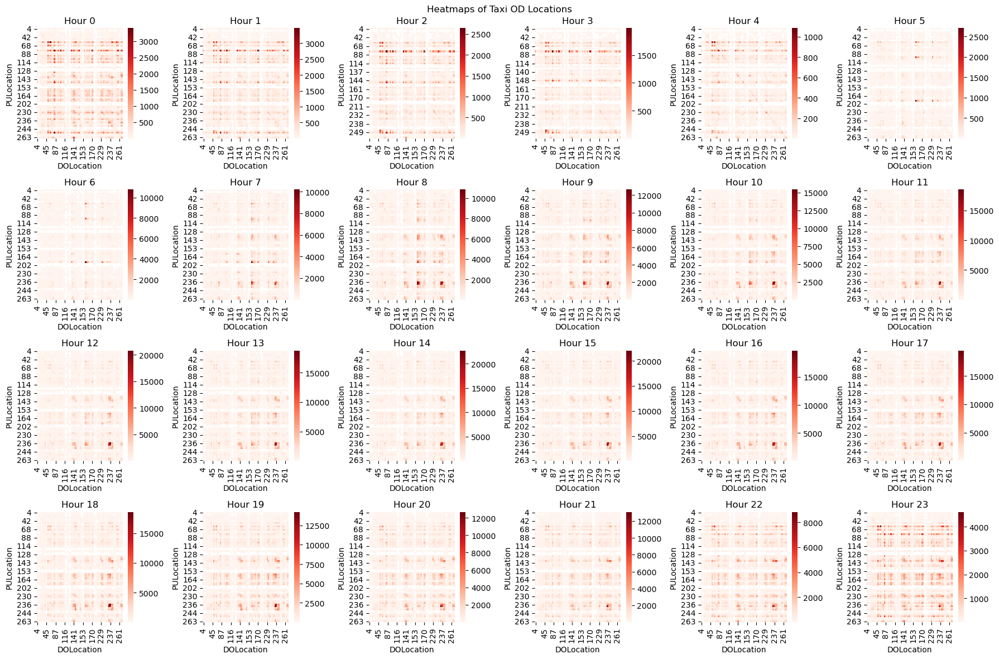

In [9]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


# Set up the figure and axes
fig, axs = plt.subplots(4, 6, figsize=(18, 12))
fig.suptitle('Heatmaps of Taxi OD Locations')

# Iterate over each hour and plot the heatmap in the corresponding subplot
for i in range(0,24):
    # Filter the dataframe for the current hour
    current_hour = m_tripdata['hour'].apply(lambda x:x==i)
    h_tripdata = m_tripdata[current_hour]

    h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')

    # Determine the subplot indices based on the current hour
    row = i // 6
    col = i % 6

    # Create the heatmap using seaborn in the corresponding subplot
    heatmap_df = h_counts.pivot(index='PULocationID', columns='DOLocationID', values='count')
    sns.heatmap(heatmap_df,cmap='Reds', ax=axs[row, col])

    # Set the x-axis labels to the end locations
    axs[row, col].set_xlabel('DOLocation')

    # Set the y-axis labels to the start locations
    axs[row, col].set_ylabel('PULocation')

    # Set the title of the subplot
    axs[row, col].set_title(f'Hour {i}')

    # # Set the x-axis ticks to be the end locations
    # axs[row, col].set_xticks(range(len(pivot_table.columns)))
    # axs[row, col].set_xticklabels(pivot_table.columns)

    # # Set the y-axis ticks to be the start locations
    # axs[row, col].set_yticks(range(len(pivot_table.index)))
    # axs[row, col].set_yticklabels(pivot_table.index)

    # # Rotate the x-axis tick labels for better readability
    # plt.setp(axs[row, col].get_xticklabels(), rotation=45)

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()


### Every Hour

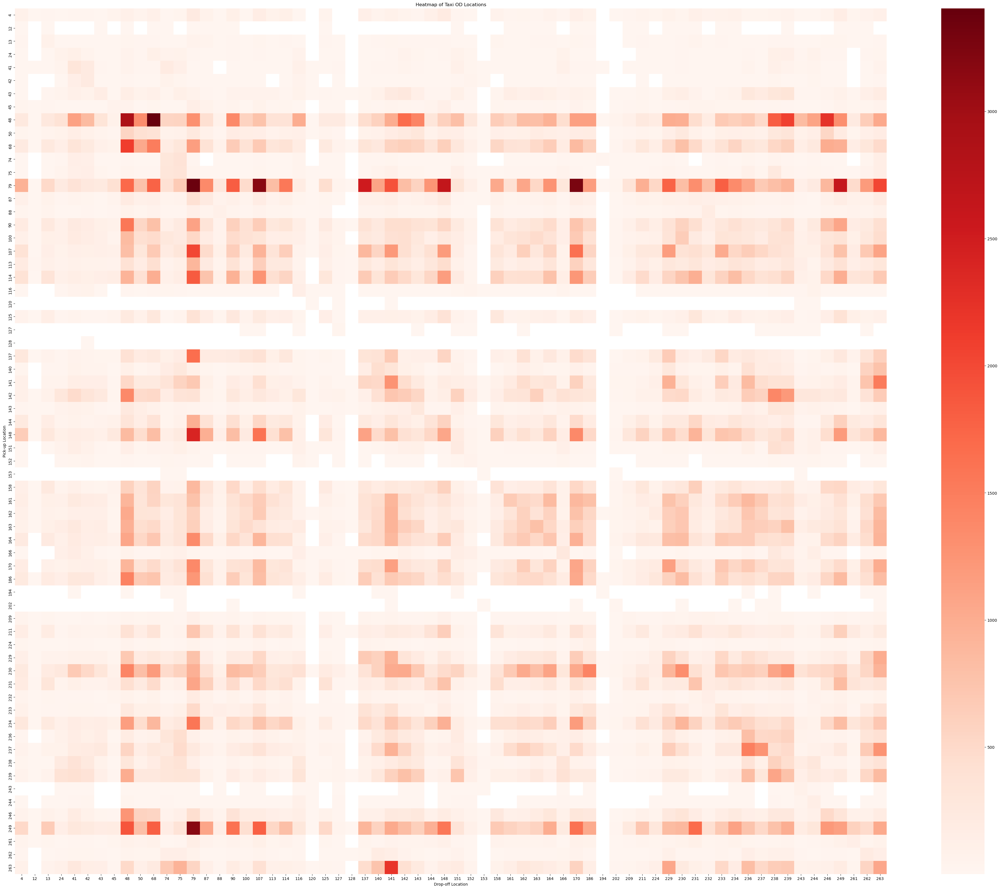

In [10]:
# 0
current_hour = m_tripdata['hour'].apply(lambda x:x==0)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 存在明显的出行记录，从48，79出发，或是从别处到48，79. 48是Clinton East，79是East Village
2. 48到68，68是East Chelsea
3. 79到107、170， 107是Gramercy，170是Murray Hill
4. 存在相当数量的从249到79的出行记录，249是West Village

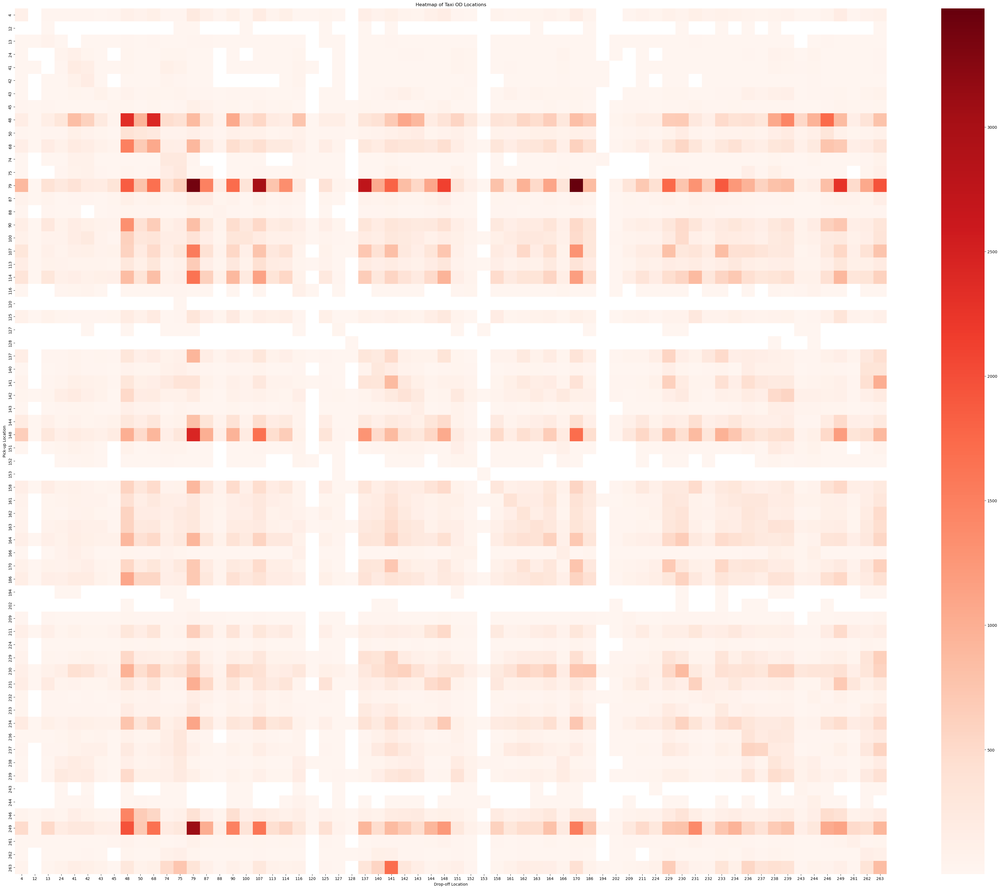

In [11]:
# 1
current_hour = m_tripdata['hour'].apply(lambda x:x==1)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 和hour1一样，79pattern一致

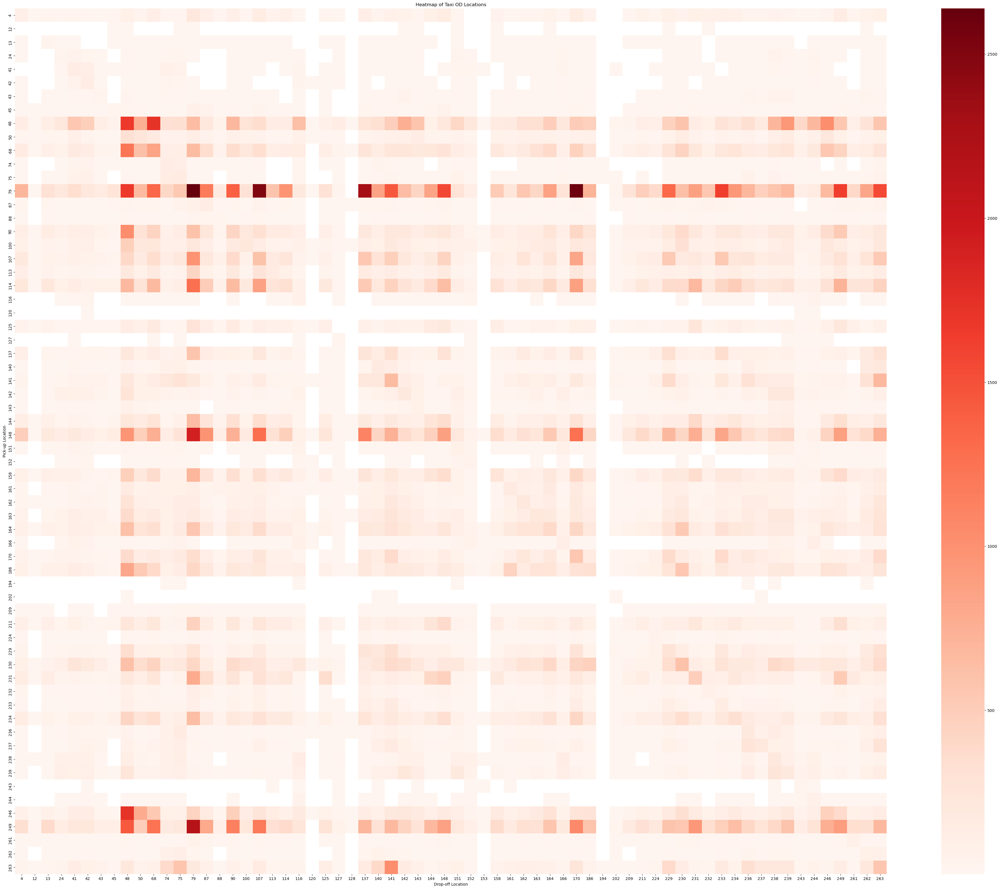

In [12]:
# 2
current_hour = m_tripdata['hour'].apply(lambda x:x==2)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 和hour1一样，79pattern一致

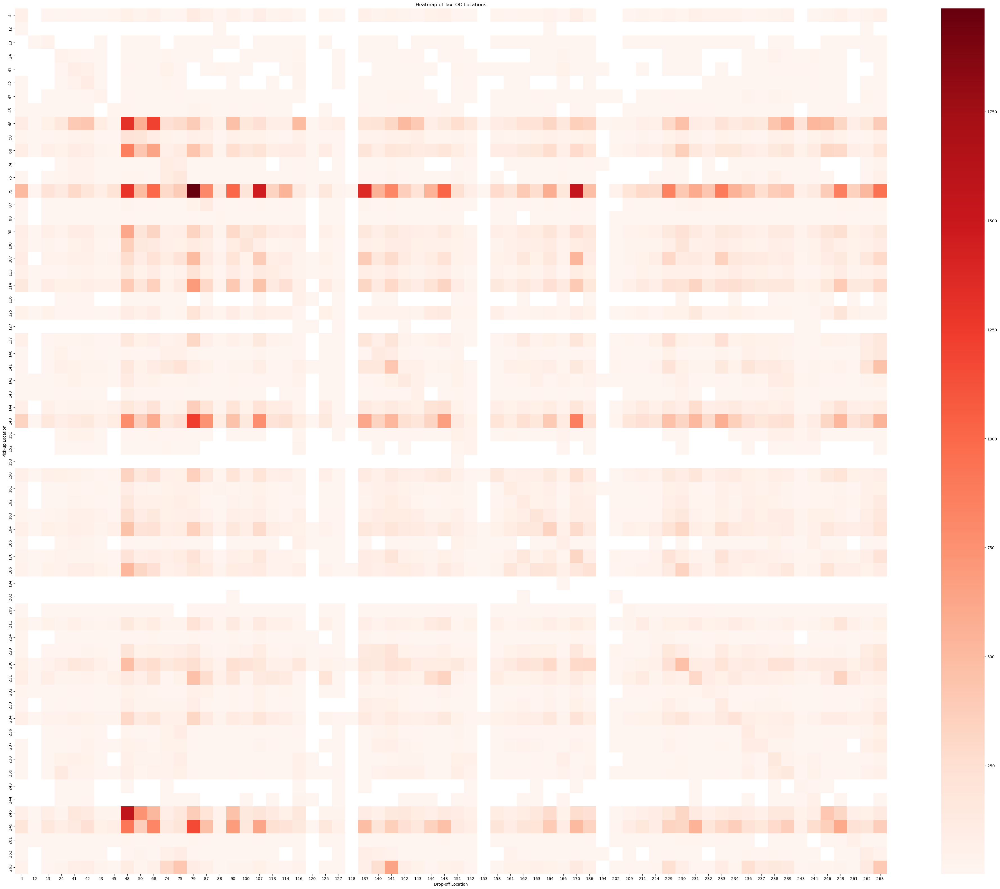

In [13]:
# 3
current_hour = m_tripdata['hour'].apply(lambda x:x==3)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 和hour1一样，79pattern一致

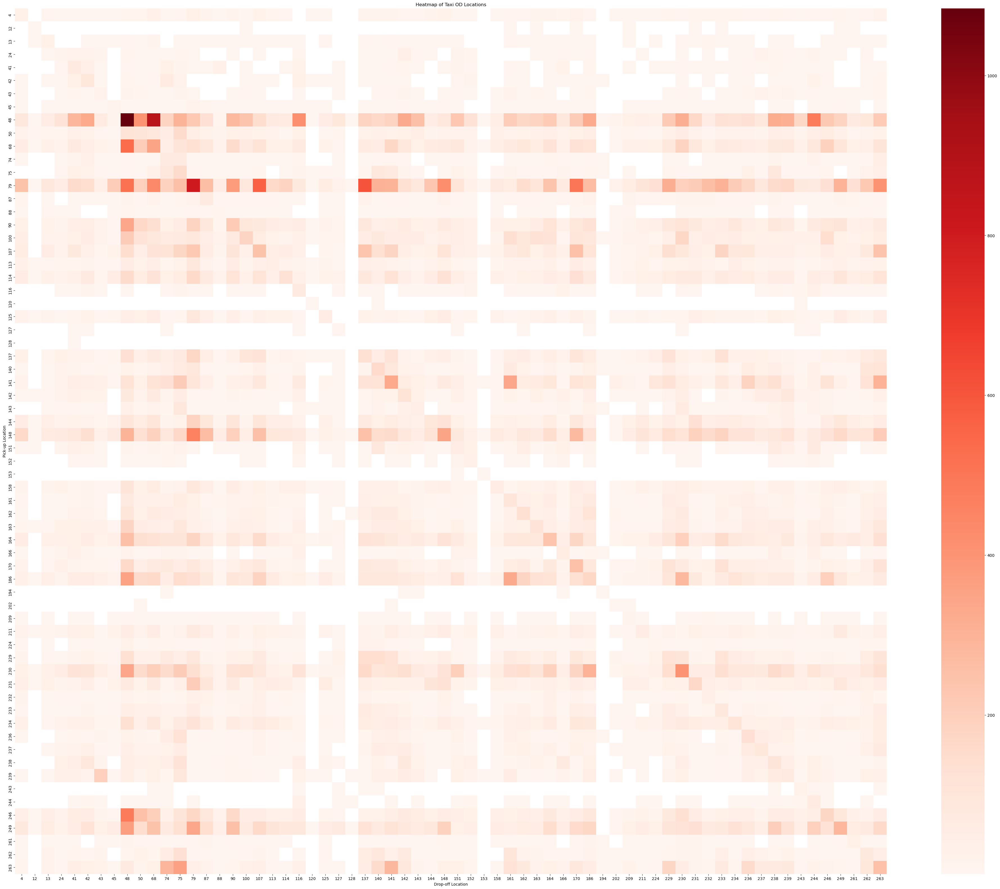

In [14]:
# 4
current_hour = m_tripdata['hour'].apply(lambda x:x==4)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 79的pattern消失，48区域开始自己内部往返

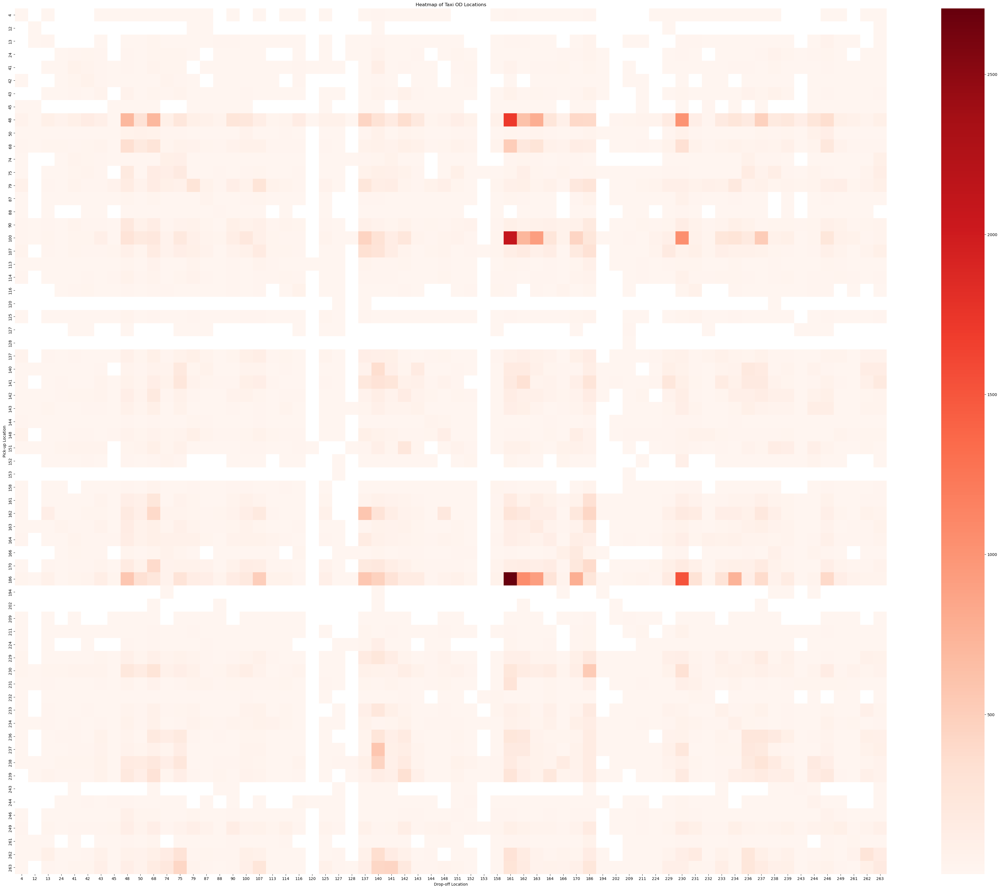

In [15]:
# 5
current_hour = m_tripdata['hour'].apply(lambda x:x==5)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 开始出现186-161pattern

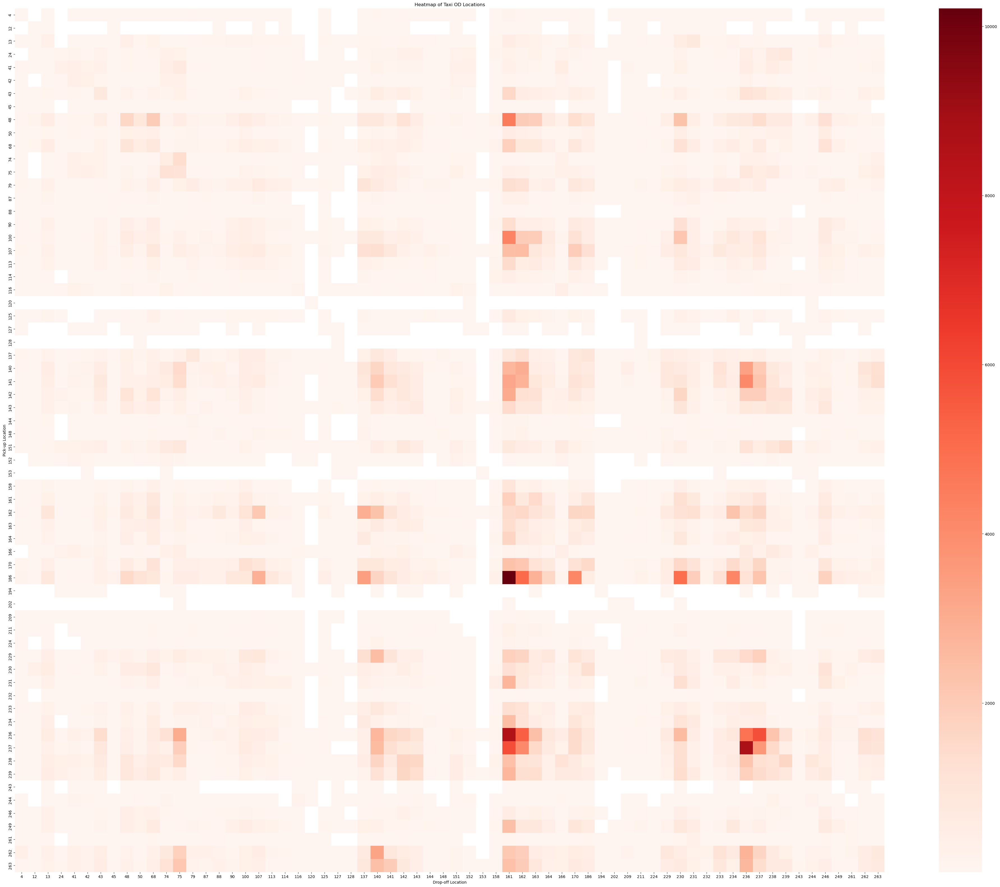

In [16]:
# 7
current_hour = m_tripdata['hour'].apply(lambda x:x==7)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 很多destination为161的出行记录，161代表Midtown center
2. 最明显的是origin为186的OD pair，186是个station
3. 236，237也有很多去往161，162的出行记录，236，237是Upper East Side North和South
4. 236，237开始出现互相往返的特征

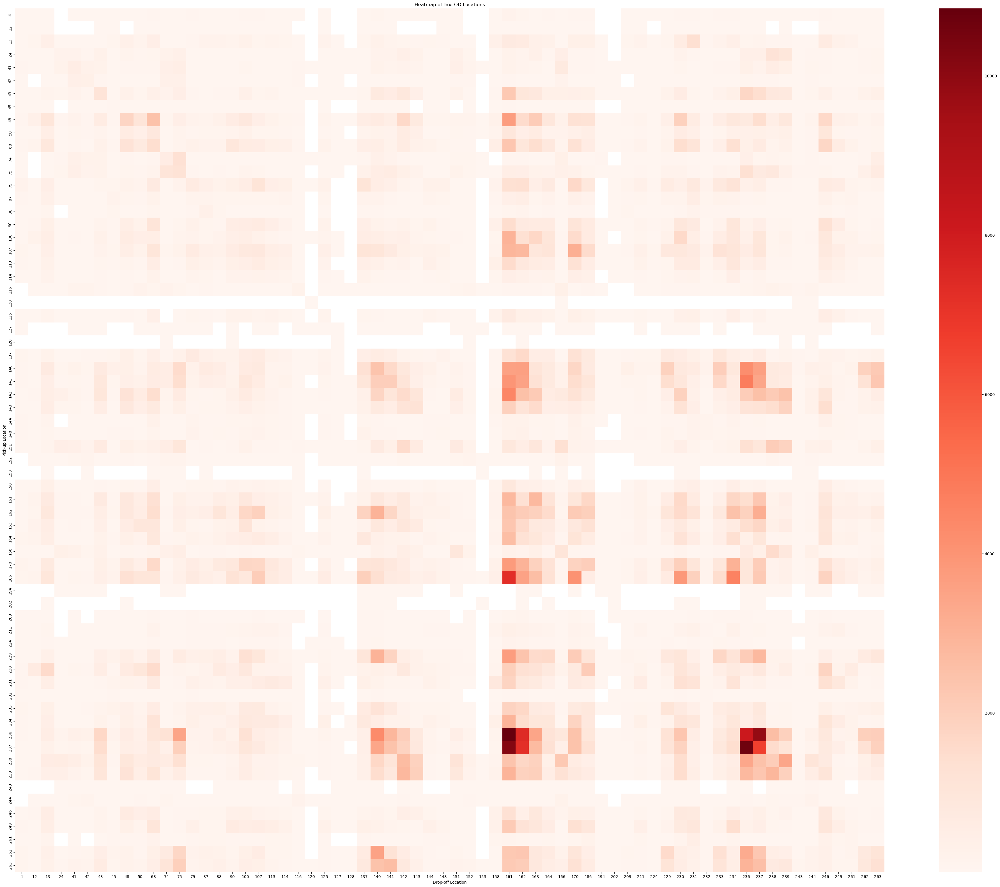

In [17]:
# 8
current_hour = m_tripdata['hour'].apply(lambda x:x==8)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 236、237到161、162的pattern
2. 236、237互相往返

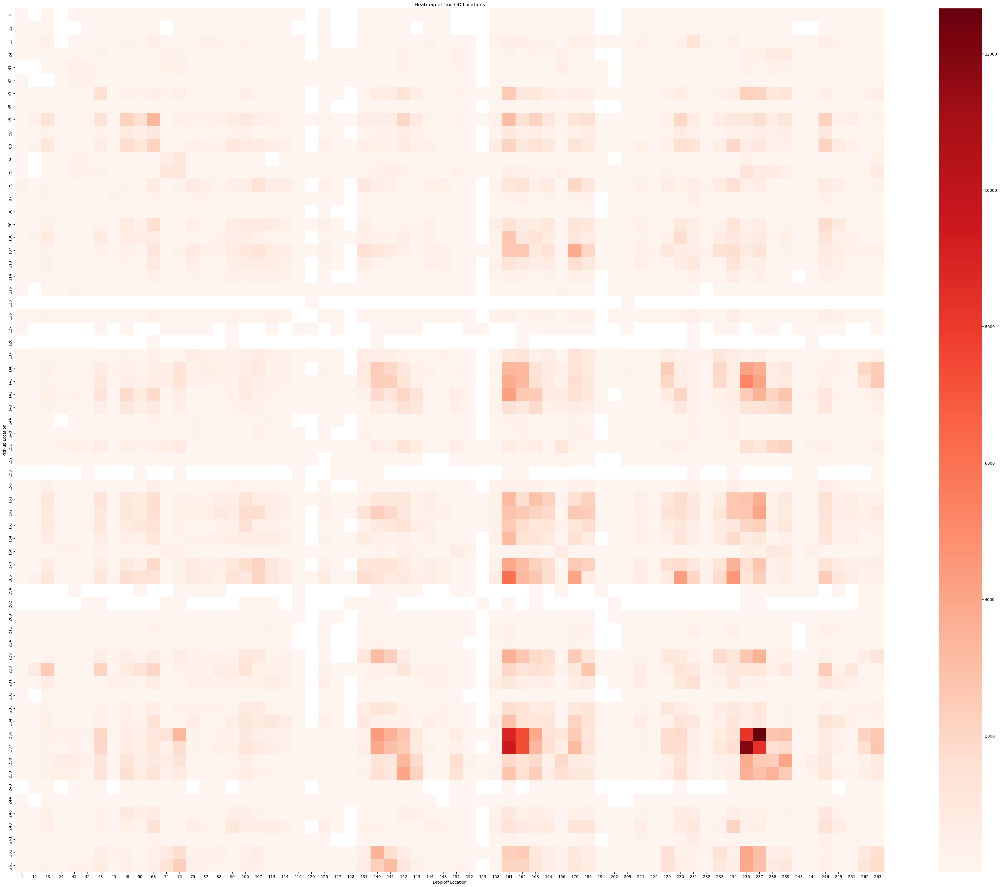

In [18]:
# 9
current_hour = m_tripdata['hour'].apply(lambda x:x==9)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 236、237到161、162的pattern逐渐减弱
2. 236、237之间的互相往返

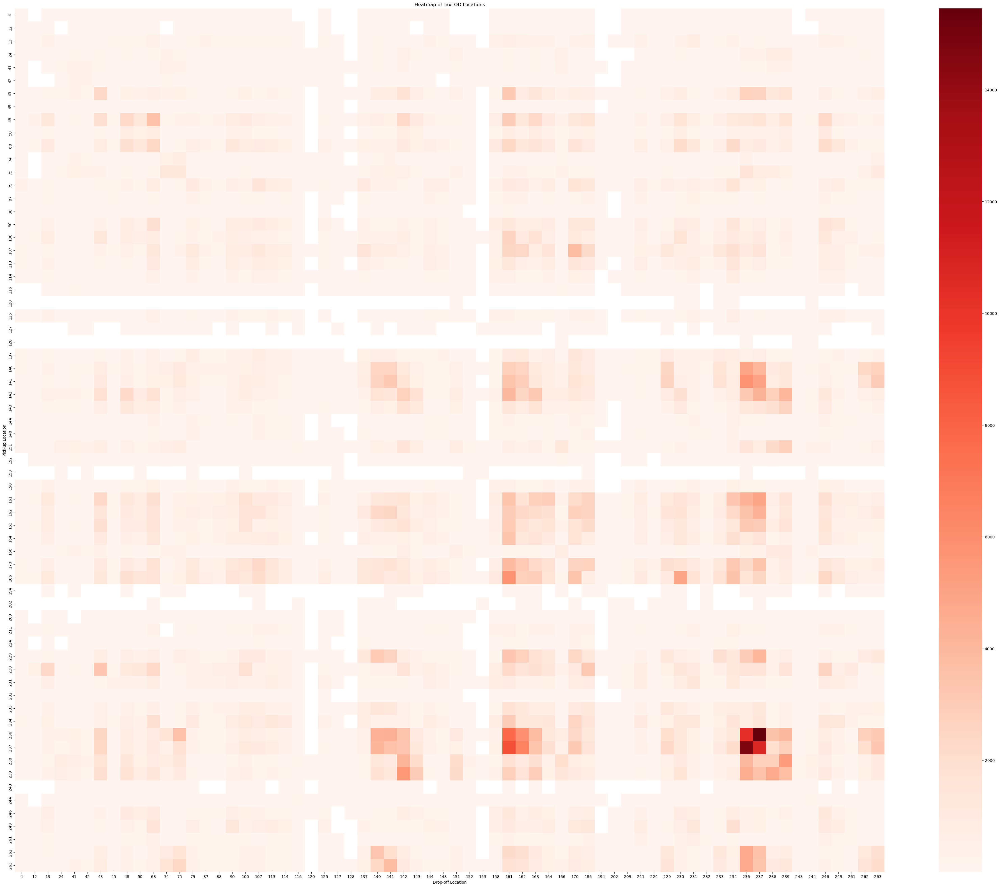

In [19]:
# 10
current_hour = m_tripdata['hour'].apply(lambda x:x==10)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 236、237到161、162的出行记录继续减少
2. 236、237的互相往返

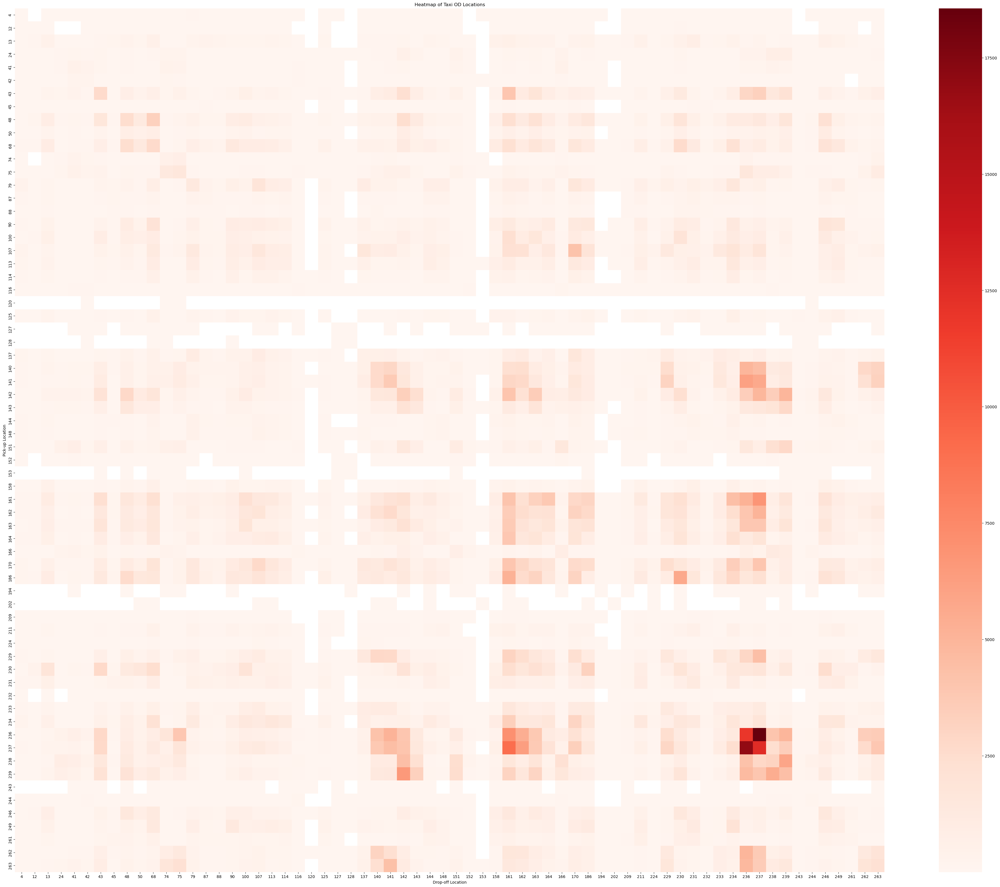

In [20]:
# 11
current_hour = m_tripdata['hour'].apply(lambda x:x==11)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 236、237到161、162的出行记录继续减少
2. 236、237的互相往返

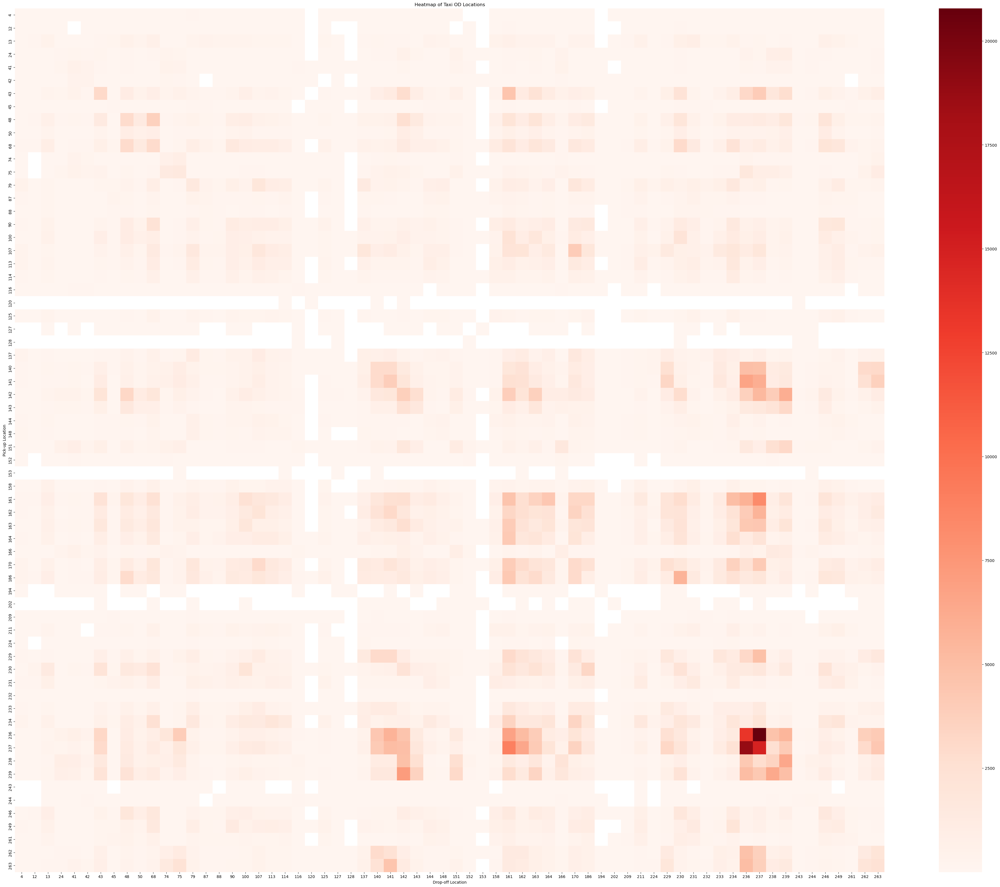

In [21]:
# 12
current_hour = m_tripdata['hour'].apply(lambda x:x==12)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 236、237到161、162的出行记录继续减少
2. 236、237的互相往返

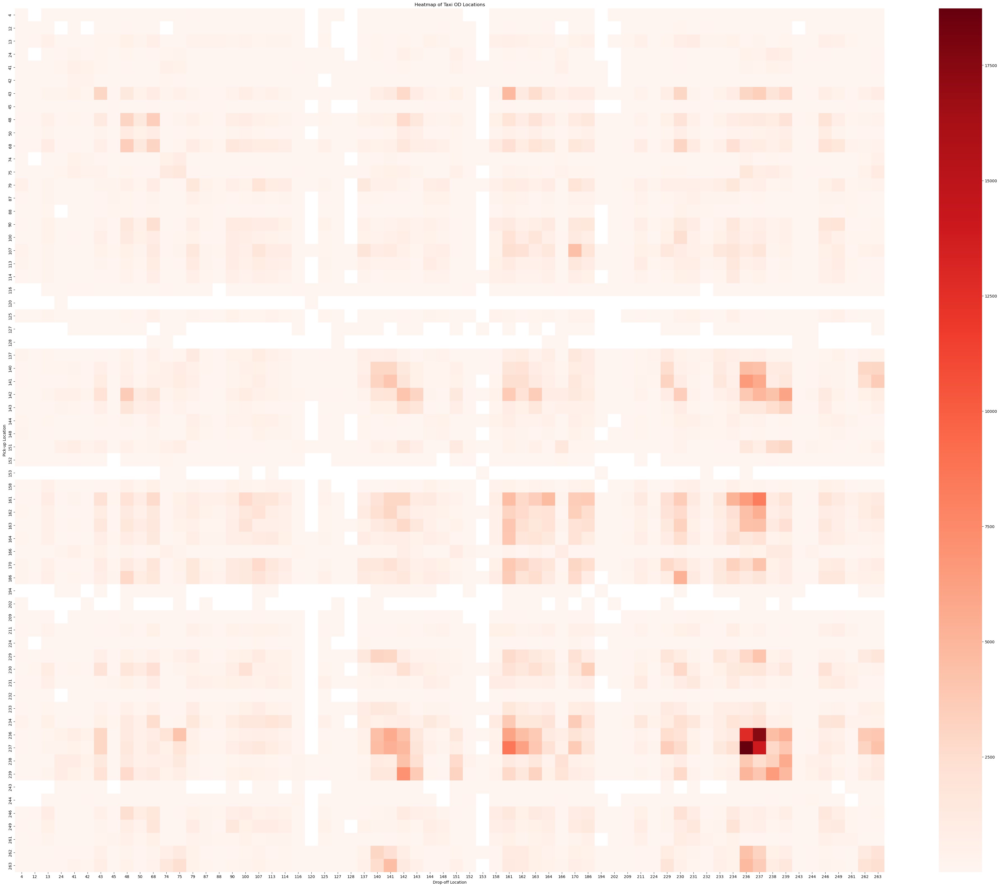

In [22]:
# 13
current_hour = m_tripdata['hour'].apply(lambda x:x==13)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)


1. 236、237的互相往返

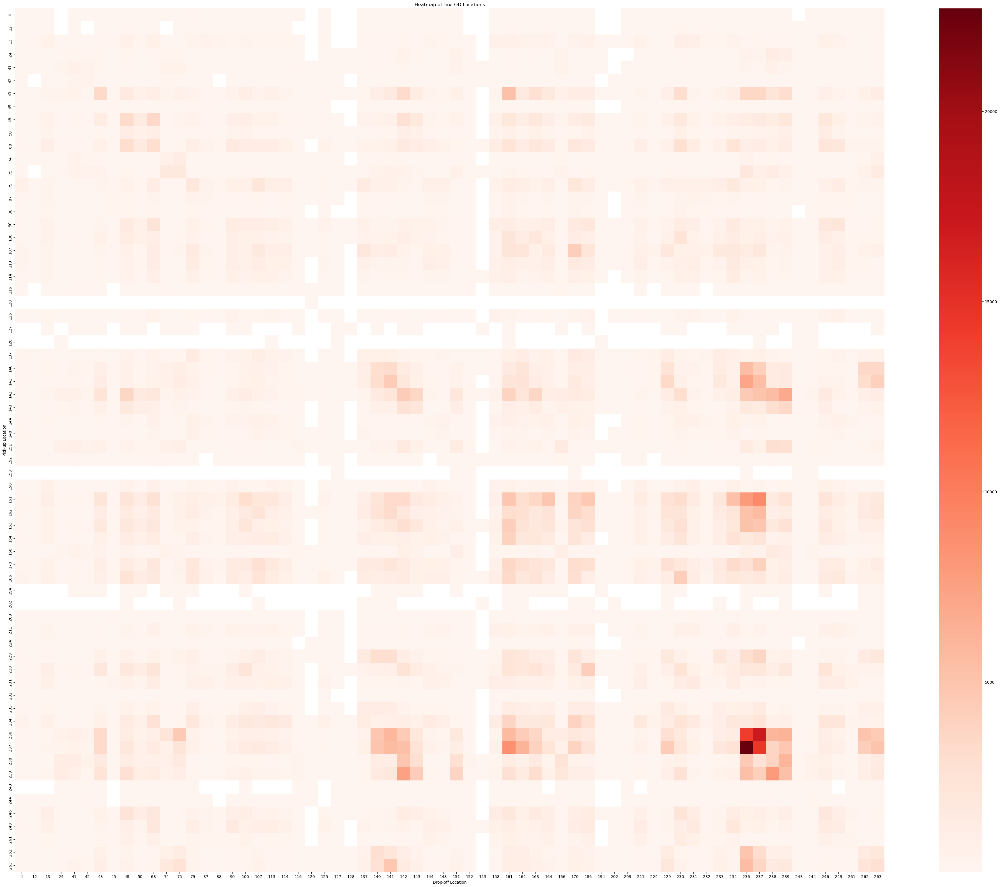

In [23]:
# 14
current_hour = m_tripdata['hour'].apply(lambda x:x==14)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 236、237的互相往返

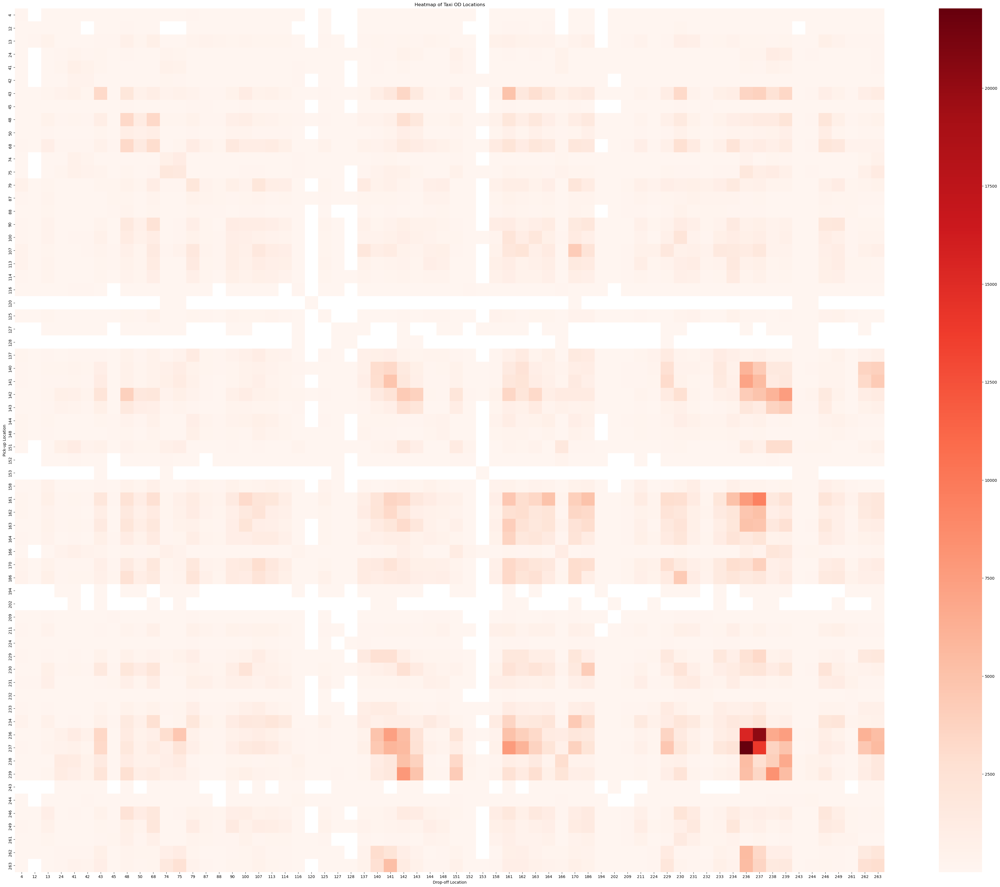

In [24]:
# 15
current_hour = m_tripdata['hour'].apply(lambda x:x==15)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 236、237的互相往返

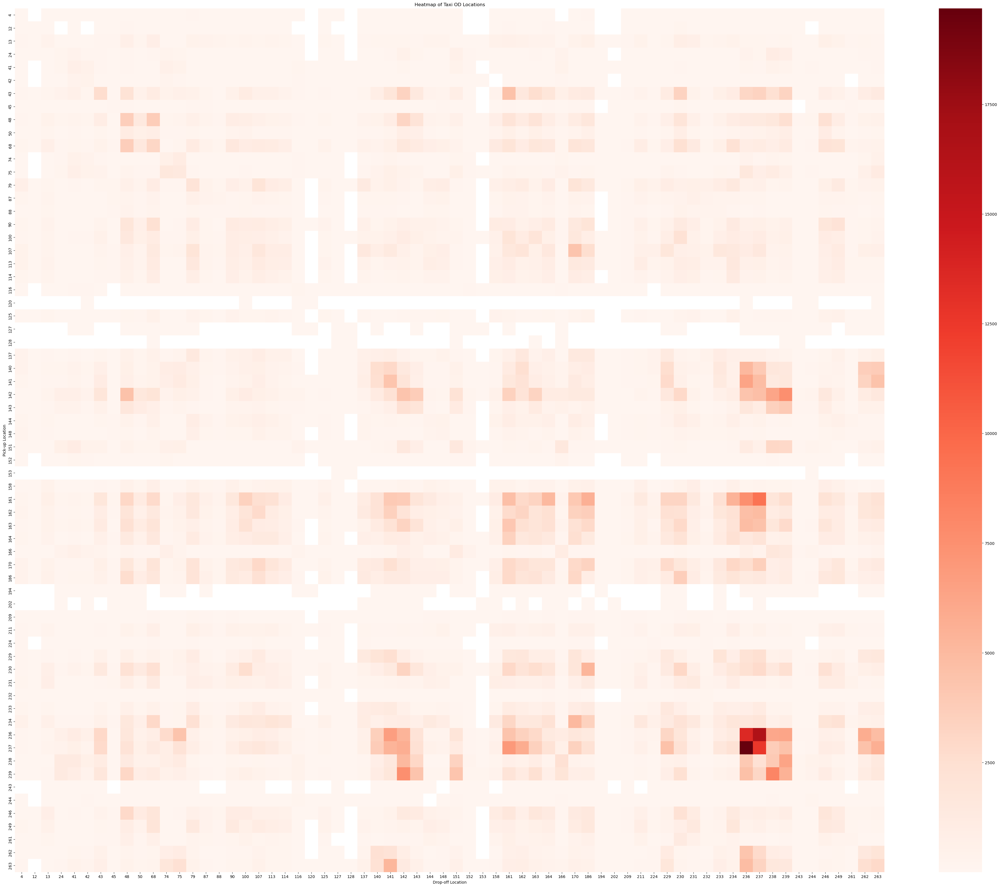

In [25]:
# 16
current_hour = m_tripdata['hour'].apply(lambda x:x==16)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 236、237的互相往返

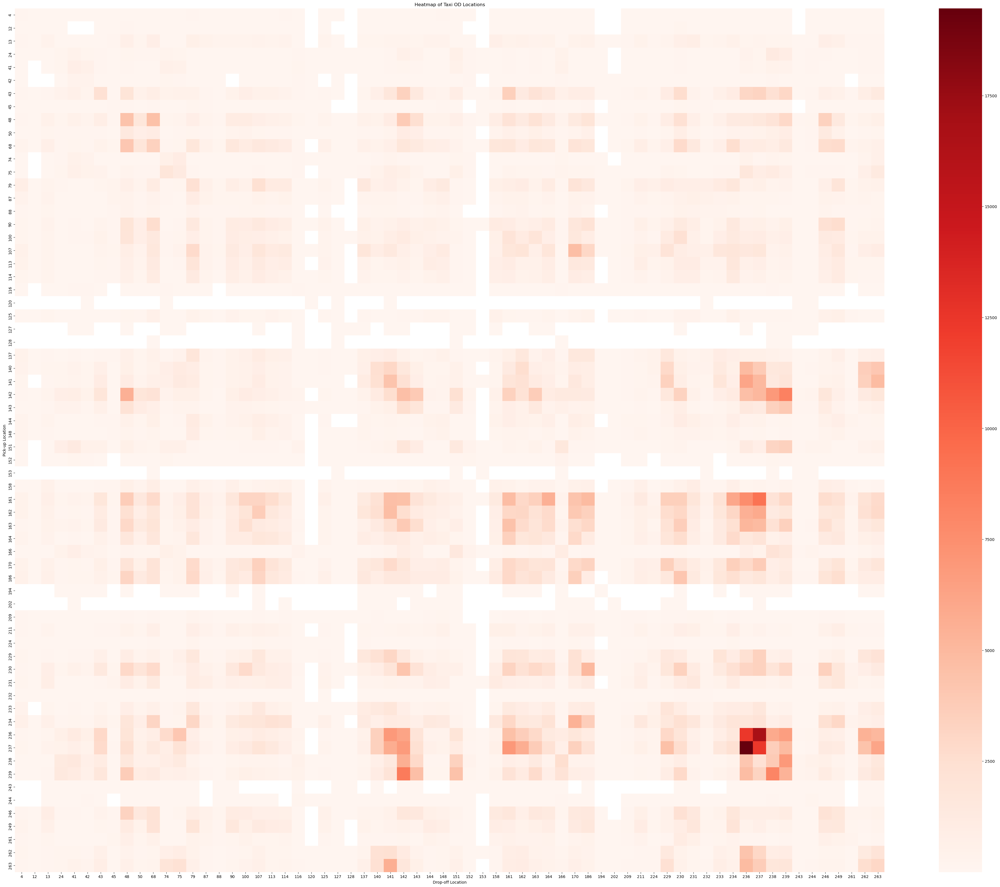

In [26]:
# 17
current_hour = m_tripdata['hour'].apply(lambda x:x==17)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 236、237的互相往返

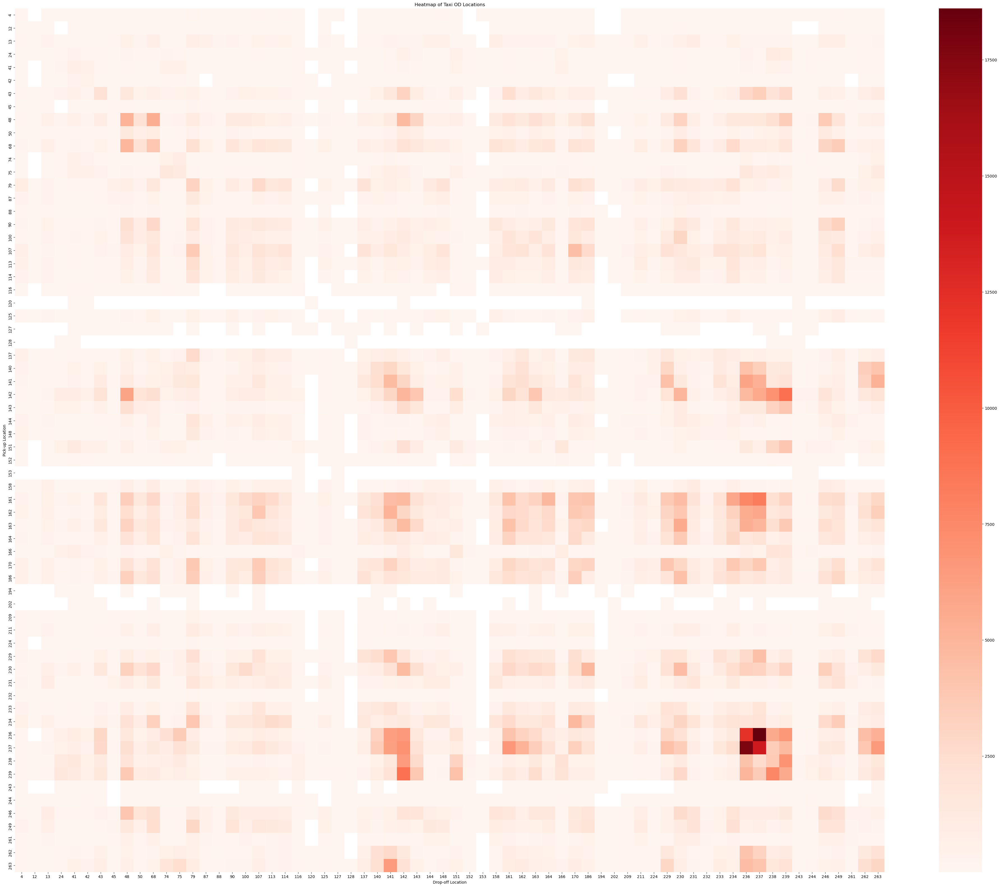

In [27]:
# 18
current_hour = m_tripdata['hour'].apply(lambda x:x==18)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 236、237的互相往返

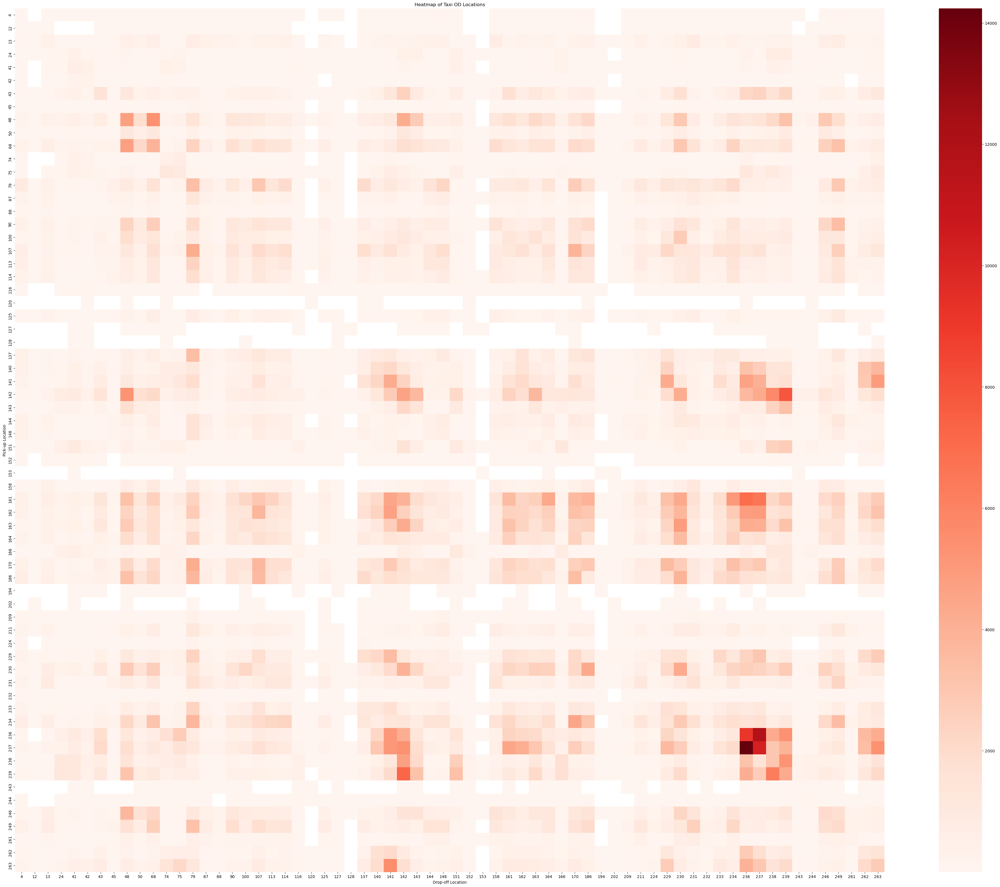

In [28]:
# 19
current_hour = m_tripdata['hour'].apply(lambda x:x==19)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

236、237的互相往返

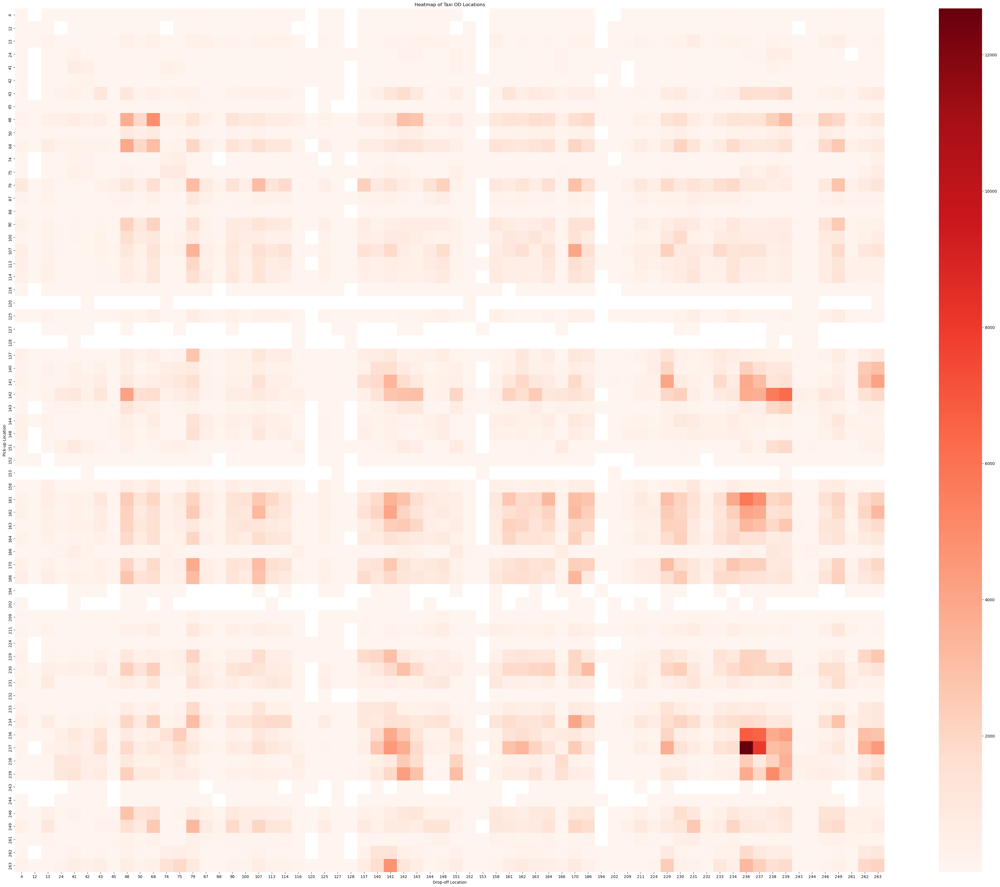

In [29]:
# 20
current_hour = m_tripdata['hour'].apply(lambda x:x==20)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 236、237的互相往返

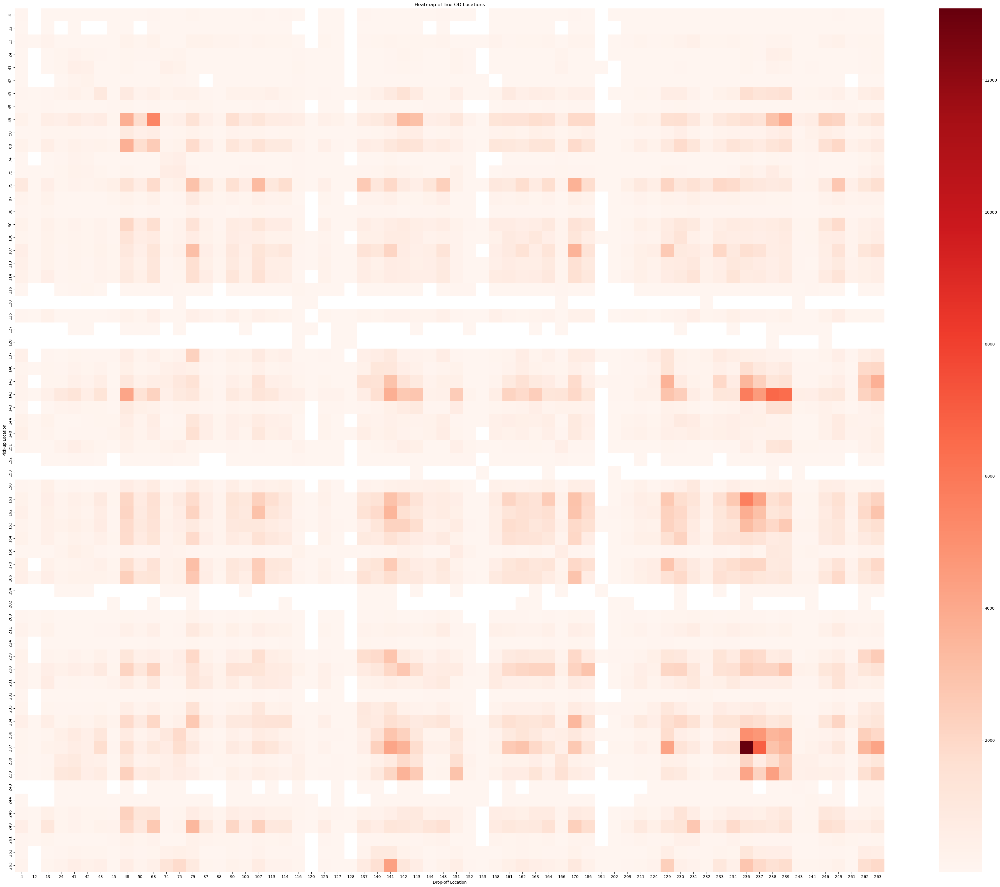

In [30]:
# 21
current_hour = m_tripdata['hour'].apply(lambda x:x==21)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 236、237的互相往返也开始减少

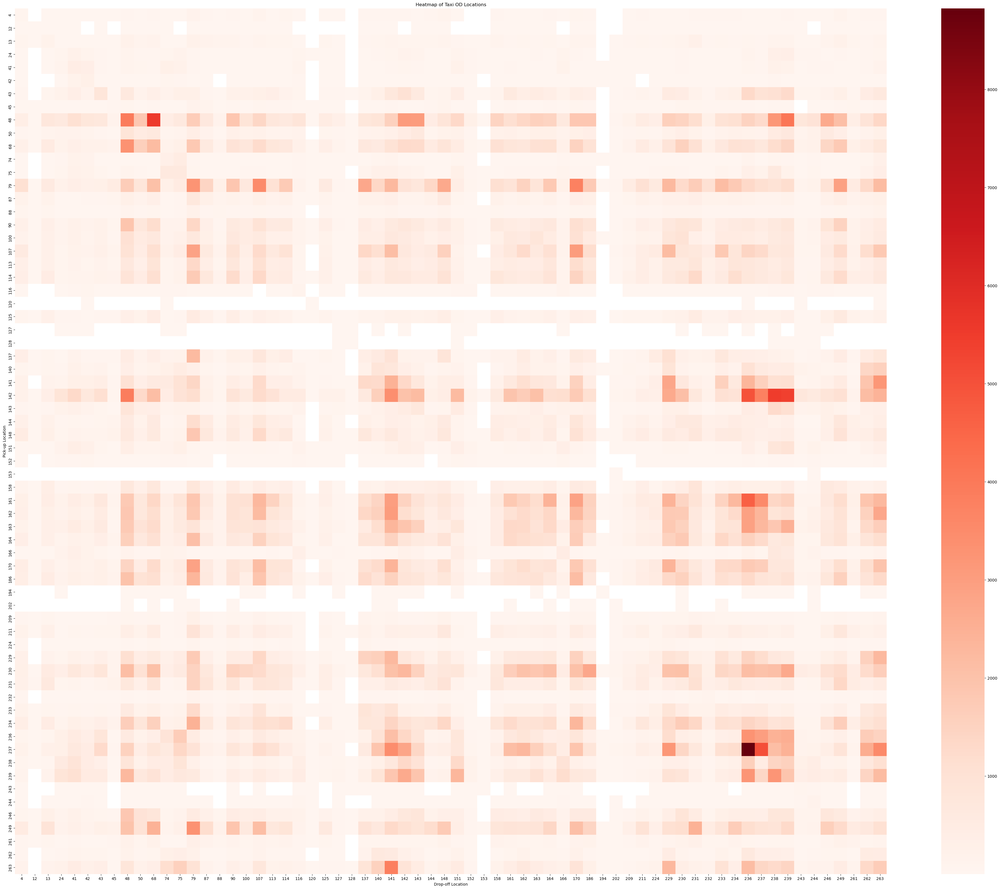

In [31]:
# 22
current_hour = m_tripdata['hour'].apply(lambda x:x==22)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 236、237的互相往返继续减少

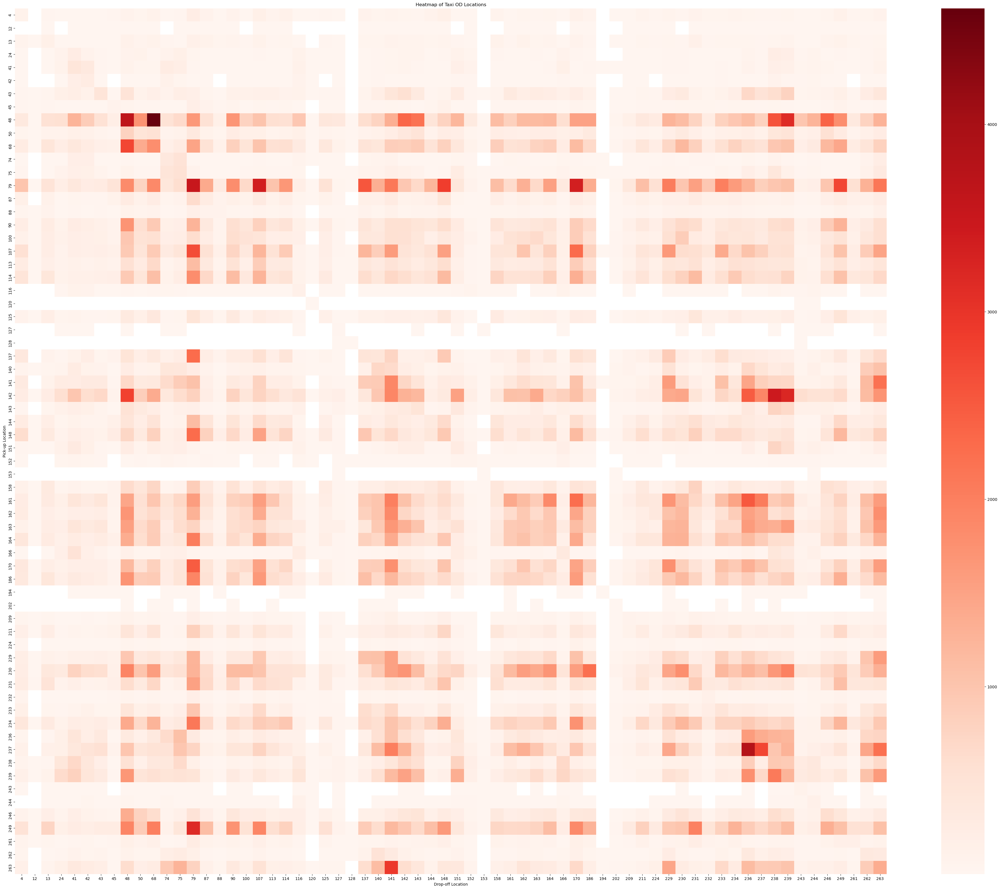

In [32]:
# 23
current_hour = m_tripdata['hour'].apply(lambda x:x==23)
h_tripdata = m_tripdata[current_hour]
h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')
data_heatmap(h_counts)

1. 开始回到0点左右的pattern，每个区域的自流动开始增多

### Two Days

In [33]:
m_tripdata['day'] = m_tripdata['tpep_pickup_datetime'].dt.dayofweek + 1
m_tripdata

,index,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,...,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,airport_fee,count,hour,day
0,0,1,2022-01-01 00:35:40,2022-01-01 00:53:29,2.0,3.80,1.0,N,142,236,...,0.5,3.65,0.0,0.3,21.95,2.5,0.0,1,0,6
1,1,1,2022-01-01 00:33:43,2022-01-01 00:42:07,1.0,2.10,1.0,N,236,42,...,0.5,4.00,0.0,0.3,13.30,0.0,0.0,1,0,6
2,2,2,2022-01-01 00:53:21,2022-01-01 01:02:19,1.0,0.97,1.0,N,166,166,...,0.5,1.76,0.0,0.3,10.56,0.0,0.0,1,0,6
3,3,2,2022-01-01 00:25:21,2022-01-01 00:35:23,1.0,1.09,1.0,N,114,68,...,0.5,0.00,0.0,0.3,11.80,2.5,0.0,1,0,6
4,4,2,2022-01-01 00:36:48,2022-01-01 01:14:20,1.0,4.30,1.0,N,68,163,...,0.5,3.00,0.0,0.3,30.30,2.5,0.0,1,0,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32716045,3399540,2,2022-12-31 23:01:46,2022-12-31 23:26:45,NaN,3.97,NaN,None,107,50,...,0.5,5.51,0.0,1.0,33.06,NaN,NaN,1,23,6
32716046,3399542,2,2022-12-31 23:06:51,2022-12-31 23:17:08,NaN,0.91,NaN,None,68,48,...,0.5,4.33,0.0,1.0,25.98,NaN,NaN,1,23,6
32716047,3399543,2,2022-12-31 23:16:37,2022-12-31 23:34:19,NaN,7.50,NaN,None,263,261,...,0.5,3.76,0.0,1.0,41.39,NaN,NaN,1,23,6
32716048,3399545,2,2022-12-31 23:13:24,2022-12-31 23:29:08,NaN,5.06,NaN,None,75,50,...,0.5,0.00,0.0,1.0,30.23,NaN,NaN,1,23,6


In [34]:
# Mon to Tue
m2t = m_tripdata['day'].apply(lambda x: (x==1) or (x==2))
m2t_tripdata = m_tripdata[m2t]
m2t_tripdata

,index,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,...,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,airport_fee,count,hour,day
91423,117145,2,2022-01-03 00:02:48,2022-01-03 00:04:53,1.0,0.35,1.0,N,116,152,...,0.5,0.00,0.0,0.3,4.80,0.0,0.0,1,0,1
91818,117836,2,2022-01-03 00:01:18,2022-01-03 00:06:52,5.0,0.83,1.0,N,186,246,...,0.5,1.86,0.0,0.3,11.16,2.5,0.0,1,0,1
92308,118702,2,2022-01-03 00:10:31,2022-01-03 00:20:18,1.0,3.82,1.0,N,237,42,...,0.5,0.00,0.0,0.3,15.80,2.5,0.0,1,0,1
92309,118703,1,2022-01-03 00:56:35,2022-01-03 01:02:23,1.0,0.90,1.0,N,48,50,...,0.5,2.00,0.0,0.3,10.80,2.5,0.0,1,0,1
92310,118704,2,2022-01-03 00:00:47,2022-01-03 00:10:06,1.0,2.21,1.0,N,41,75,...,0.5,0.00,0.0,0.3,10.30,0.0,0.0,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32709477,3391122,2,2022-12-27 23:47:57,2022-12-27 23:57:50,NaN,0.92,NaN,None,230,230,...,0.5,0.00,0.0,1.0,46.75,NaN,NaN,1,23,2
32709478,3391124,2,2022-12-27 23:28:32,2022-12-27 23:40:13,NaN,2.81,NaN,None,234,87,...,0.5,2.00,0.0,1.0,23.75,NaN,NaN,1,23,2
32709479,3391125,1,2022-12-27 23:27:22,2022-12-27 23:45:02,NaN,0.00,NaN,None,246,141,...,0.5,0.00,0.0,1.0,22.75,NaN,NaN,1,23,2
32709480,3391126,1,2022-12-27 23:10:58,2022-12-27 23:24:55,NaN,2.90,NaN,None,186,239,...,0.5,2.99,0.0,1.0,22.89,NaN,NaN,1,23,2


In [35]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


# Set up the figure and axes
fig, axs = plt.subplots(6, 8, figsize=(180, 120))
fig.suptitle('Heatmaps of Taxi OD Locations')

for i in range(1,3):
    # Iterate over each hour and plot the heatmap in the corresponding subplot
    for j in range(0,24):
        # Filter the dataframe for the current hour
        current_day = m2t_tripdata['day'].apply(lambda x: x==i)
        current_hour = m2t_tripdata['hour'].apply(lambda x:x==j)
        h_tripdata = m2t_tripdata[(current_day) & (current_hour)]

        h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')

        # Determine the subplot indices based on the current hour
        row = ((i-1)*24 + j) // 8
        col = ((i-1)*24 + j) % 8
        # Create the heatmap using seaborn in the corresponding subplot
        heatmap_df = h_counts.pivot(index='PULocationID', columns='DOLocationID', values='count')
        sns.heatmap(heatmap_df,cmap='Reds', ax=axs[row, col])

        # Set the x-axis labels to the end locations
        axs[row, col].set_xlabel('DOLocation')

        # Set the y-axis labels to the start locations
        axs[row, col].set_ylabel('PULocation')

        # Set the title of the subplot
        axs[row, col].set_title(f'Day {i} Hour {j}')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()


In [36]:
# Tue to Wed
t2w = m_tripdata['day'].apply(lambda x: (x==2) or (x==3))
t2w_tripdata = m_tripdata[t2w]

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


# Set up the figure and axes
fig, axs = plt.subplots(6, 8, figsize=(180, 120))
fig.suptitle('Heatmaps of Taxi OD Locations')

for i in range(2,4):
    # Iterate over each hour and plot the heatmap in the corresponding subplot
    for j in range(0,24):
        # Filter the dataframe for the current hour
        current_day = t2w_tripdata['day'].apply(lambda x: x==i)
        current_hour = t2w_tripdata['hour'].apply(lambda x:x==j)
        h_tripdata = t2w_tripdata[(current_day) & (current_hour)]

        h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')

        # Determine the subplot indices based on the current hour
        row = ((i-2)*24 + j) // 8
        col = ((i-2)*24 + j) % 8
        # Create the heatmap using seaborn in the corresponding subplot
        heatmap_df = h_counts.pivot(index='PULocationID', columns='DOLocationID', values='count')
        sns.heatmap(heatmap_df,cmap='Reds', ax=axs[row, col])

        # Set the x-axis labels to the end locations
        axs[row, col].set_xlabel('DOLocation')

        # Set the y-axis labels to the start locations
        axs[row, col].set_ylabel('PULocation')

        # Set the title of the subplot
        axs[row, col].set_title(f'Day {i} Hour {j}')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()


In [37]:
# Wed to Thu
w2t = m_tripdata['day'].apply(lambda x: (x==3) or (x==4))
w2t_tripdata = m_tripdata[w2t]

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


# Set up the figure and axes
fig, axs = plt.subplots(6, 8, figsize=(180, 120))
fig.suptitle('Heatmaps of Taxi OD Locations')

for i in range(3,5):
    # Iterate over each hour and plot the heatmap in the corresponding subplot
    for j in range(0,24):
        # Filter the dataframe for the current hour
        current_day = w2t_tripdata['day'].apply(lambda x: x==i)
        current_hour = w2t_tripdata['hour'].apply(lambda x:x==j)
        h_tripdata = w2t_tripdata[(current_day) & (current_hour)]

        h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')

        # Determine the subplot indices based on the current hour
        row = ((i-3)*24 + j) // 8
        col = ((i-3)*24 + j) % 8
        # Create the heatmap using seaborn in the corresponding subplot
        heatmap_df = h_counts.pivot(index='PULocationID', columns='DOLocationID', values='count')
        sns.heatmap(heatmap_df,cmap='Reds', ax=axs[row, col])

        # Set the x-axis labels to the end locations
        axs[row, col].set_xlabel('DOLocation')

        # Set the y-axis labels to the start locations
        axs[row, col].set_ylabel('PULocation')

        # Set the title of the subplot
        axs[row, col].set_title(f'Day {i} Hour {j}')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()


In [38]:
# Thu to Fri
t2f = m_tripdata['day'].apply(lambda x: (x==4) or (x==5))
t2f_tripdata = m_tripdata[t2f]

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


# Set up the figure and axes
fig, axs = plt.subplots(6, 8, figsize=(180, 120))
fig.suptitle('Heatmaps of Taxi OD Locations')

for i in range(4,6):
    # Iterate over each hour and plot the heatmap in the corresponding subplot
    for j in range(0,24):
        # Filter the dataframe for the current hour
        current_day = t2f_tripdata['day'].apply(lambda x: x==i)
        current_hour = t2f_tripdata['hour'].apply(lambda x:x==j)
        h_tripdata = t2f_tripdata[(current_day) & (current_hour)]

        h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')

        # Determine the subplot indices based on the current hour
        row = ((i-4)*24 + j) // 8
        col = ((i-4)*24 + j) % 8
        # Create the heatmap using seaborn in the corresponding subplot
        heatmap_df = h_counts.pivot(index='PULocationID', columns='DOLocationID', values='count')
        sns.heatmap(heatmap_df,cmap='Reds', ax=axs[row, col])

        # Set the x-axis labels to the end locations
        axs[row, col].set_xlabel('DOLocation')

        # Set the y-axis labels to the start locations
        axs[row, col].set_ylabel('PULocation')

        # Set the title of the subplot
        axs[row, col].set_title(f'Day {i} Hour {j}')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()


In [39]:
# Fri to Sat
f2s = m_tripdata['day'].apply(lambda x: (x==5) or (x==6))
f2s_tripdata = m_tripdata[f2s]

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


# Set up the figure and axes
fig, axs = plt.subplots(6, 8, figsize=(180, 120))
fig.suptitle('Heatmaps of Taxi OD Locations')

for i in range(5,7):
    # Iterate over each hour and plot the heatmap in the corresponding subplot
    for j in range(0,24):
        # Filter the dataframe for the current hour
        current_day = f2s_tripdata['day'].apply(lambda x: x==i)
        current_hour = f2s_tripdata['hour'].apply(lambda x:x==j)
        h_tripdata = f2s_tripdata[(current_day) & (current_hour)]

        h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')

        # Determine the subplot indices based on the current hour
        row = ((i-5)*24 + j) // 8
        col = ((i-5)*24 + j) % 8
        # Create the heatmap using seaborn in the corresponding subplot
        heatmap_df = h_counts.pivot(index='PULocationID', columns='DOLocationID', values='count')
        sns.heatmap(heatmap_df,cmap='Reds', ax=axs[row, col])

        # Set the x-axis labels to the end locations
        axs[row, col].set_xlabel('DOLocation')

        # Set the y-axis labels to the start locations
        axs[row, col].set_ylabel('PULocation')

        # Set the title of the subplot
        axs[row, col].set_title(f'Day {i} Hour {j}')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()


In [40]:
# Sat to Sun
s2s = m_tripdata['day'].apply(lambda x: (x==6) or (x==7))
s2s_tripdata = m_tripdata[s2s]

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


# Set up the figure and axes
fig, axs = plt.subplots(6, 8, figsize=(180, 120))
fig.suptitle('Heatmaps of Taxi OD Locations')

for i in range(6,8):
    # Iterate over each hour and plot the heatmap in the corresponding subplot
    for j in range(0,24):
        # Filter the dataframe for the current hour
        current_day = s2s_tripdata['day'].apply(lambda x: x==i)
        current_hour = s2s_tripdata['hour'].apply(lambda x:x==j)
        h_tripdata = s2s_tripdata[(current_day) & (current_hour)]

        h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')

        # Determine the subplot indices based on the current hour
        row = ((i-6)*24 + j) // 8
        col = ((i-6)*24 + j) % 8
        # Create the heatmap using seaborn in the corresponding subplot
        heatmap_df = h_counts.pivot(index='PULocationID', columns='DOLocationID', values='count')
        sns.heatmap(heatmap_df,cmap='Reds', ax=axs[row, col])

        # Set the x-axis labels to the end locations
        axs[row, col].set_xlabel('DOLocation')

        # Set the y-axis labels to the start locations
        axs[row, col].set_ylabel('PULocation')

        # Set the title of the subplot
        axs[row, col].set_title(f'Day {i} Hour {j}')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()


In [41]:
# Sun to Mon
s2m = m_tripdata['day'].apply(lambda x: (x==7) or (x==1))
s2m_tripdata = m_tripdata[s2m]

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns


# Set up the figure and axes
fig, axs = plt.subplots(6, 8, figsize=(180, 120))
fig.suptitle('Heatmaps of Taxi OD Locations')

for i in [7,1]:
    # Iterate over each hour and plot the heatmap in the corresponding subplot
    for j in range(0,24):
        # Filter the dataframe for the current hour
        current_day = s2m_tripdata['day'].apply(lambda x: x==i)
        current_hour = s2m_tripdata['hour'].apply(lambda x:x==j)
        h_tripdata = s2m_tripdata[(current_day) & (current_hour)]

        h_counts = h_tripdata[['PULocationID','DOLocationID']].value_counts().reset_index(name='count')

        # Determine the subplot indices based on the current hour
        if i==7:
          row = j // 8
          col = j % 8
        else:
          row = (24 + j) // 8
          col = (24 + j) % 8
        # Create the heatmap using seaborn in the corresponding subplot
        heatmap_df = h_counts.pivot(index='PULocationID', columns='DOLocationID', values='count')
        sns.heatmap(heatmap_df,cmap='Reds', ax=axs[row, col])

        # Set the x-axis labels to the end locations
        axs[row, col].set_xlabel('DOLocation')

        # Set the y-axis labels to the start locations
        axs[row, col].set_ylabel('PULocation')

        # Set the title of the subplot
        axs[row, col].set_title(f'Day {i} Hour {j}')

# Adjust the spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()
